In [1]:
import warnings
warnings.filterwarnings("ignore") 

In [2]:
import scutils_cnb_clean
from scutils_cnb_clean import *
np.random.seed(23942)

import networkx as nx
import oslom
from argparse import Namespace

findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.


In [3]:
%matplotlib inline

In [4]:
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300

In [5]:
working_dir = '/Users/burdziac/Documents/PDAC/notebooks_final_June2021/'

# Hard-Coded Metadata

In [6]:
color_dict= {"T1 (Basal)":"#DAF7A6",
"T2":"#A1BE6C",
"T3":"#EED04D",
"T3.5":"#D4AA47",
"T4-day1":"#1D89E3",
"T4":"#1D89E3",
"T5":"#F8BADE",
"T6":"#D16BA7",
"T7_PDAC":"#BD14DA",
"T8_LiverMet":"#63009B",
"T8_PDAC_LiverMets":"#63009B",
"T8_PDAC_LungMets":"#63009B"}

In [7]:
stage_dict = {'184RH_PDAC-PT_KATE_GFP': 'T7_PDAC',
 '184RRH_LIVmet': 'T8_PDAC_LiverMets',
 'Ag-PDAC-PT-Kate': 'T7_PDAC',
 'D396_EPI': 'T3.5',
 'DAC_B528-Kate+': 'T4',
 'DAC_B530-Kate+': 'T2',
 'DAC_C263_EPI': 'T3.5',
 'DAC_C269_EPI': 'T5',
 'DAC_C301-EPI_1': 'T6',
 'DAC_C301-EPI_2': 'T6',
 'DAC_D020_p5_Epi': 'T7_PDAC',
 'DAC_DI143_Epi': 'T5',
 'DACC963_mKate_plus': 'T8_PDAC_LungMets',
 'DACC963LIVERmet': 'T8_LiverMet',
 'DACC963PT_Kate_plus': 'T7_PDAC',
 'DACD351_Kate_plus': 'T3',
 'DACD394_Kate_plus': 'T3',
 'DACD403_Kate_plus': 'T2',
 'DACD404_Kate_plus': 'T4',
 'DACD406_Kate_plus': 'T3',
 'DACD407_Kate_plus': 'T4-day1',
 'DACD482_Kate_plus': 'T5',
 'Ag-Lung-Mets-Kate': 'T8_PDAC_LungMets',
 'DACD511_Kate_plus': 'T1 (Basal)',
 'DACD550_kate_plus': 'T1 (Basal)'}

In [8]:
order = ['DACD406_Kate_plus',
'DACD351_Kate_plus',
"DACD404_Kate_plus",
"DACD407_Kate_plus",
"DAC_DI143_Epi",
"DACD482_Kate_plus"]

# Functions

In [9]:
def initial_graph(corr_matrix,
                  correlation_threshold,
                  gene_list):
                  #genes_of_interest=None):
    
    #create networkx graph G from thresholded correlation matrix
    G = nx.convert_matrix.from_numpy_matrix((corr_matrix>=correlation_threshold)*corr_matrix)
    
    #re-name nodes to gene names
    gene_mapping = {i:gene_list[i] for i in range(len(gene_list))}
    G = nx.relabel_nodes(G, gene_mapping, copy=True)
    return G

In [10]:
def refine_graph_jaccard(G,gene_list,corr_matrix,
                         prune_thresh=.15,
                         prune_thresh_upper = .85):
    
    gene_list = list(gene_list) #ensure this is a list and not an array for compatibility below

    Gpruned = G.copy()
    
    preds = nx.algorithms.link_prediction.jaccard_coefficient(G,G.edges)
    for u,v,p in preds:
        if p < prune_thresh:
            Gpruned.remove_edge(u, v)
    
    preds = nx.algorithms.link_prediction.jaccard_coefficient(G)
    for u,v,p in preds:
        if p > prune_thresh_upper:
            Gpruned.add_edge(u, v, weight=corr_matrix[gene_list.index(u),gene_list.index(v)])

    return Gpruned

In [11]:
def run_oslom(G):
    args = Namespace()
    args.min_cluster_size = 5
    args.oslom_args = oslom.DEF_OSLOM_ARGS
    
    #edited version of OSLOM to fix dependency issue
    args.oslom_exec = "/Users/burdziac/Documents/PDAC/notebooks_final_June2021/scripts/OSLOM2/oslom_undir"

    edges = G.edges.data("weight", default=1)
    clusters = oslom.run_in_memory(args,edges)
    
    clusters_ = [clusters[0]['clusters'][i]['nodes'] for i in range(len(clusters[0]['clusters']))]

    cliques_iterative = []
    for clust in clusters_:
        cliques_iterative.append([dict_['id'] for dict_ in clust])

    return cliques_iterative

In [12]:
def get_modules(corr_matrix, gene_list, 
                     correlation_threshold=.1,
                     prune_thresh=.4,
                     prune_thresh_upper = None):
    
    G = initial_graph(corr_matrix,correlation_threshold,gene_list)
    
    Gpruned = refine_graph_jaccard(G,gene_list,corr_matrix,
                                               prune_thresh=prune_thresh,
                                               prune_thresh_upper=prune_thresh_upper)

    cliques_communities = run_oslom(Gpruned)
    

    return cliques_communities, G, Gpruned

# Load Data Original Data and Impute with Magic

In [13]:
sc = load_sc(working_dir+"saved_analyses/ImmuneCrosstalkSet_v1.pickle")

In [14]:
#remove 0 sum genes
sc.data_normalized = sc.data_normalized.iloc[:,np.where(sc.data_normalized.sum(0).values!=0)[0]]
sc.genes = sc.data_normalized.columns

#impute with MAGIC
magic_operator = magic.MAGIC(t=3,n_pca=50)
sc.data_imputed = magic_operator.fit_transform(np.log2(sc.data_normalized+.1))

Calculating MAGIC...
  Running MAGIC on 8525 cells and 16723 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 6.16 seconds.
    Calculating KNN search...
    Calculated KNN search in 3.33 seconds.
    Calculating affinities...
    Calculated affinities in 3.29 seconds.
  Calculated graph and diffusion operator in 13.41 seconds.
  Running MAGIC with `solver='exact'` on 16723-dimensional data may take a long time. Consider denoising specific genes with `genes=<list-like>` or using `solver='approximate'`.
  Calculating imputation...
  Calculated imputation in 25.42 seconds.
Calculated MAGIC in 40.02 seconds.


# R-L Co-expression Analysis

In [15]:
RL = pd.read_csv(working_dir+"misc_files/Ligand_Receptor_Pairs_DAC-curated_TWedit_correctedCNB.csv")[['Ligand','Receptor']]

In [16]:
receptor_fixed = [gene.strip().upper() for gene in RL['Receptor'].dropna().values]
ligand_fixed = [gene.strip().upper() for gene in RL['Ligand'].dropna().values]

In [17]:
RL_list = list(set(np.concatenate((receptor_fixed,ligand_fixed))))
RL_list = np.intersect1d(RL_list,list(sc.data_normalized))
RLdata_imputed = sc.data_imputed[RL_list]
RLdata_normalized = np.log2(sc.data_normalized[RL_list]+.1)

In [18]:
RLcorr = np.corrcoef(RLdata_imputed.T)
RLcorr_norm = np.corrcoef(RLdata_normalized.T)

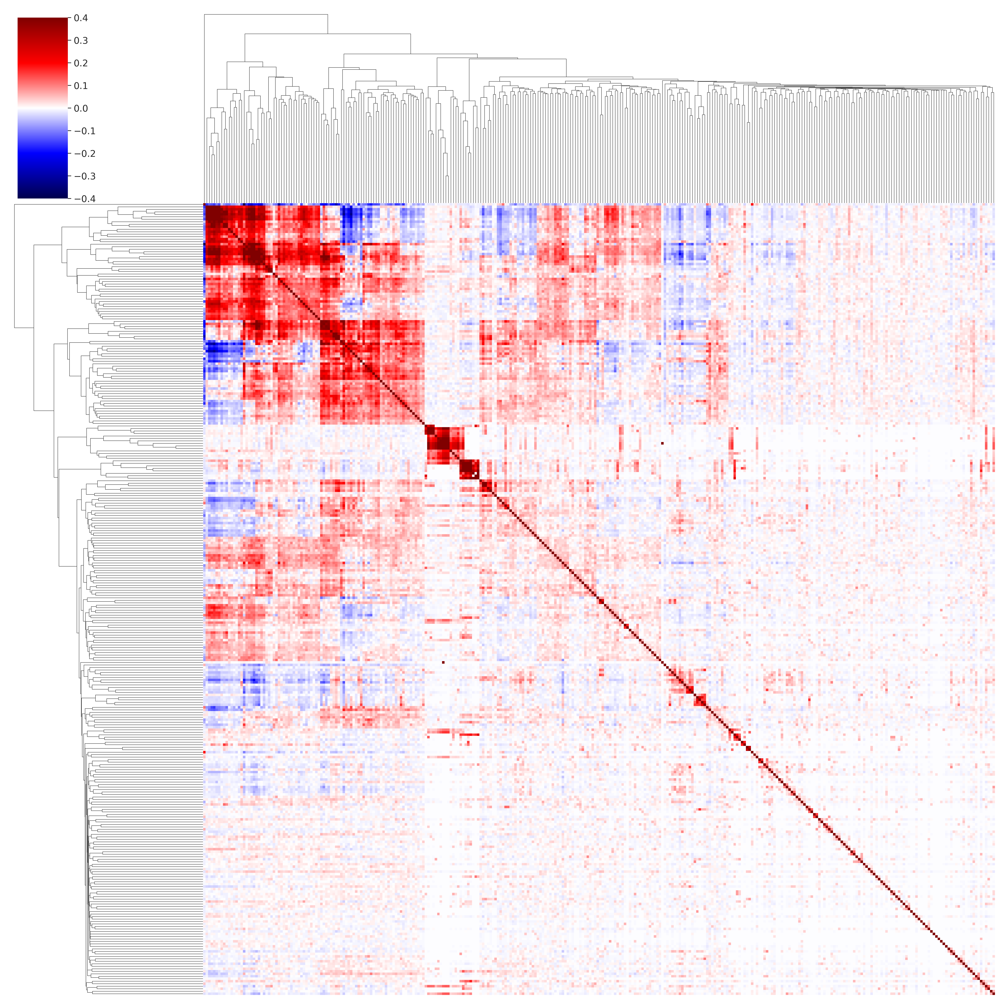

In [19]:
sns.clustermap(RLcorr_norm,figsize=(20,20),cmap='seismic',
               yticklabels="",xticklabels="",vmax=.4,vmin=-.4)

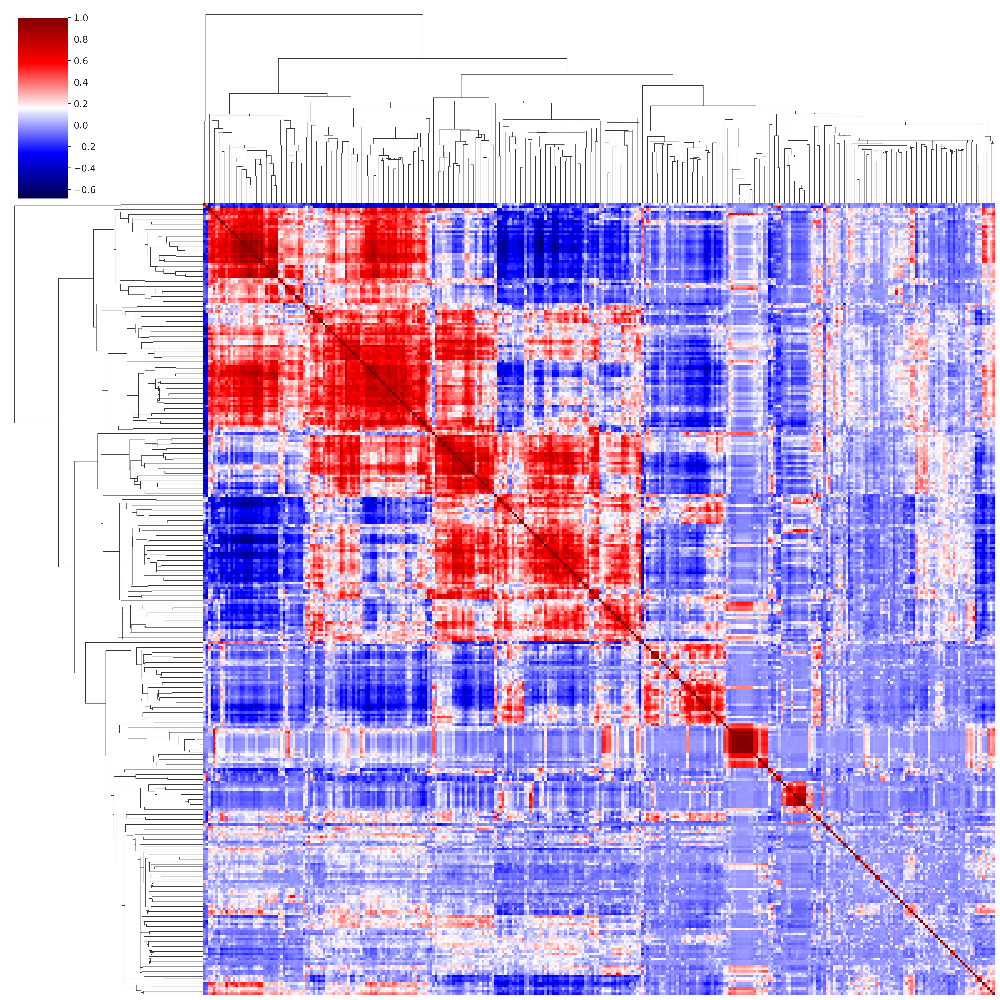

In [20]:
#this clustering better represented module overlap than default
row_clust = scipy.cluster.hierarchy.linkage(RLcorr, method='centroid', metric='euclidean', optimal_ordering=False)

clustmap = sns.clustermap(RLcorr,figsize=(20,20),cmap='seismic',
               yticklabels="",xticklabels="",col_linkage=row_clust,row_linkage=row_clust)

# Module Detection Algorithm

## Run Algorithm

In [21]:
cliques_iterative, G, Gpruned = get_modules(RLcorr,RL_list,
                               prune_thresh=.05,
                               prune_thresh_upper=.95,
                               correlation_threshold = .4,)

## Visualize Networks

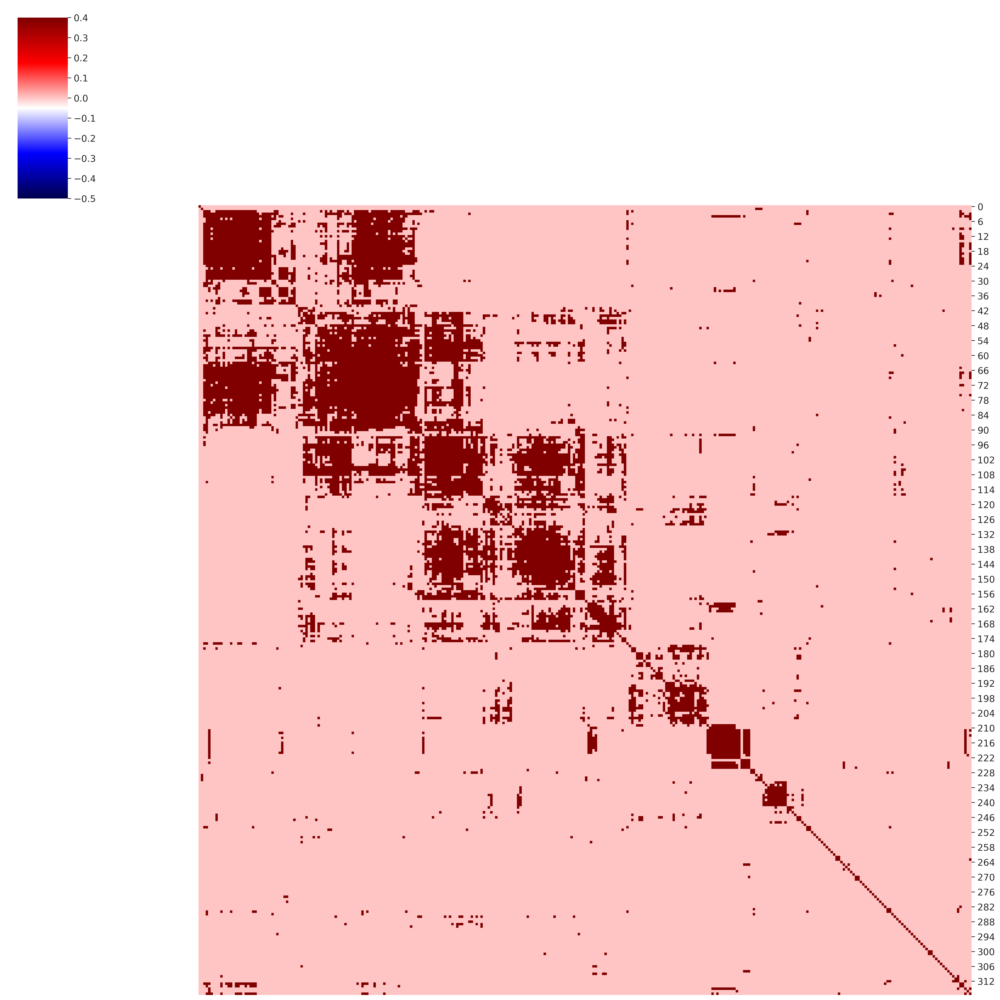

In [22]:
A = nx.linalg.graphmatrix.adjacency_matrix(G)
sns.clustermap((A.toarray()>0)[clustmap.dendrogram_row.reordered_ind,:][:,clustmap.dendrogram_col.reordered_ind]
               ,figsize=(20,20),cmap='seismic',col_cluster=False,row_cluster=False,xticklabels="",vmax=.4,vmin=-.5)

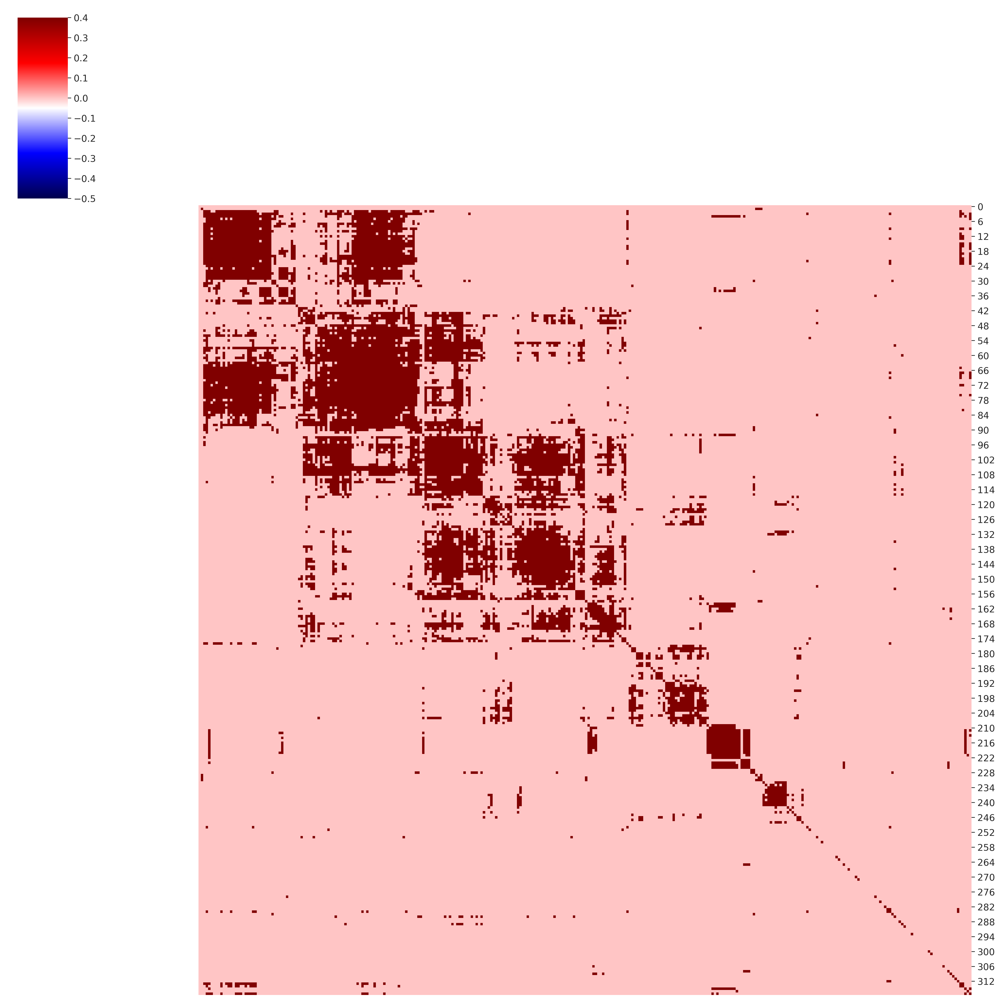

In [23]:
Apruned = nx.linalg.graphmatrix.adjacency_matrix(Gpruned)
sns.clustermap((Apruned.toarray()>0)[clustmap.dendrogram_row.reordered_ind,:][:,clustmap.dendrogram_col.reordered_ind]
               ,figsize=(20,20),cmap='seismic',col_cluster=False,row_cluster=False,xticklabels="",vmax=.4,vmin=-.5)

## Visualize Identified Modules

In [24]:
#use exact modules from paper
cliques_iterative_filtered = pickle.load(open(working_dir+"analysis_outputs/crosstalk/cliques_iterative_filtered_Epi.pickle",'rb'))

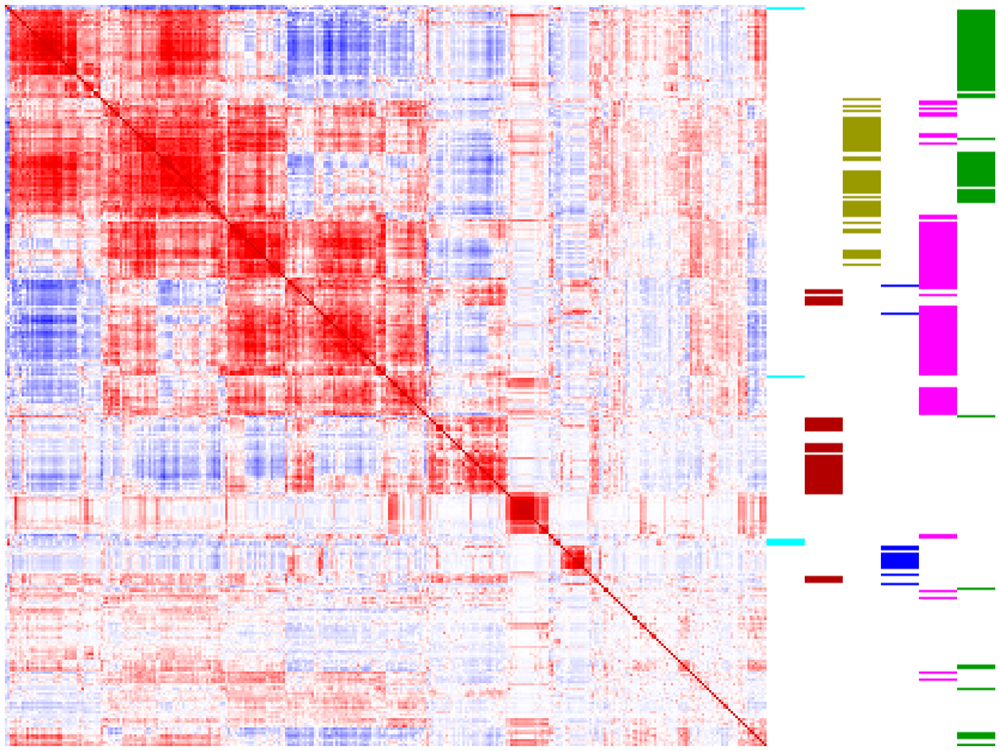

In [25]:
fig,ax=plt.subplots(1,7,figsize=(26,20),gridspec_kw={'width_ratios':(20,1,1,1,1,1,1)})

rgb_cols = np.array([[0,1,1],
[.7,0,0],
[.6,.6,0],
[0,0,1],
[1,0,1],
[0,.6,0],])

#axis 0: heatmap
RLcorr_reordered = RLcorr[clustmap.dendrogram_row.reordered_ind,:][:,clustmap.dendrogram_row.reordered_ind]
gene_reordered = np.array(RL_list)[clustmap.dendrogram_row.reordered_ind]
sns.heatmap(RLcorr_reordered,cmap='seismic',cbar=False,
               yticklabels="",xticklabels="",vmax=1.5,vmin=-1.5,ax=ax[0])

#axis 1-7: module colors
for j,clique in enumerate([0,1,2,4,5,6]):
    col_rgb_colors = np.array([rgb_cols[j,:] if gene in cliques_iterative_filtered[clique] else np.array([1,1,1]) for gene in gene_reordered])

    #col_rgb_colors = np.asarray([rgb_cols[j,:]])
    ax[j+1].imshow(np.tile(col_rgb_colors[:, None, :], [1, 1000, 1]),aspect="auto")
    ax[j+1].set_axis_off()


plt.subplots_adjust(wspace=0, hspace=.05)
plt.savefig(working_dir+"final_figures/Figure4/ProgressionCohortInfModules_HeatmapModuleAnnotation_Jan-23-22.png",bbox_inches='tight')
plt.savefig(working_dir+"final_figures/Figure4/ProgressionCohortInfModules_HeatmapModuleAnnotation_Jan-23-22.pdf",bbox_inches='tight')

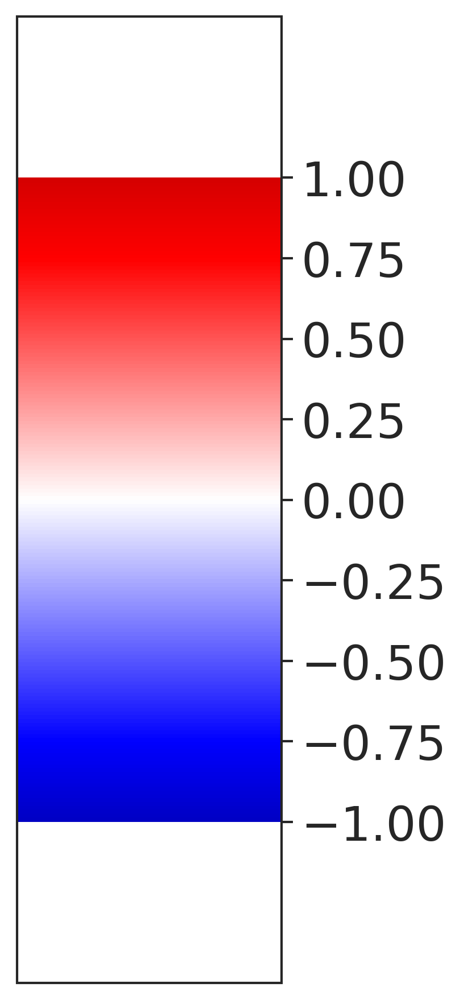

In [26]:
fig,ax = plt.subplots(figsize=(2,5))

#adding colorbar
cmap = plt.get_cmap('seismic')
norm = mpl.colors.Normalize(vmin=-1.5, vmax=1.5)
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = fig.colorbar(sm,ax)
cbar.ax.set_yticks([-1,1])
for t in cbar.ax.get_yticklabels():
    t.set_fontsize(20)
cbar.ax.set_ylim([-1,1])
plt.savefig(working_dir+"final_figures/Figure4/ProgressionCohortInfModules_HeatmapModuleAnnotation_Jan-23-22_cbar.pdf",bbox_inches='tight')

## Module Pseudo-coloring Visualization

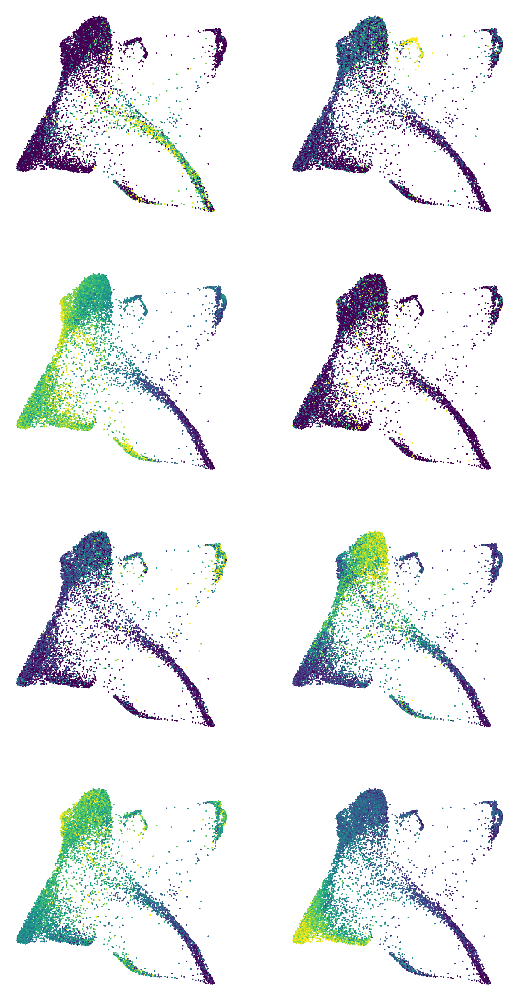

In [27]:
fig,axes=plt.subplots(4,2,figsize=(10,20))
i=0
for i,genes in enumerate(cliques_iterative):
    colors = np.log2(sc.data_normalized[genes].values.mean(1)+.1)
    order_ = np.random.choice(sc.data.shape[0],size=sc.data.shape[0],replace=False)
    ax = axes.flatten()[i]
    ax.scatter(sc.layout_log.values[:,0][order_],sc.layout_log.values[:,1][order_],c=colors[order_],s=1,
              cmap='viridis',vmin=np.percentile(colors,2),vmax=np.percentile(colors,98))
    ax.set_axis_off()
    ax.set_title("")
    i+=1
while i < 8:
    axes.flatten()[i].set_axis_off()
    i+=1

In [28]:
# cliques_iterative_filtered = []
# for cl in cliques_iterative:
#     cl_cellcounts = (sc.data_normalized[cl]>0).values.sum(0)
#     newclique=list(np.array(cl)[np.where(cl_cellcounts>=10)[0]])
#     cliques_iterative_filtered.append(newclique)

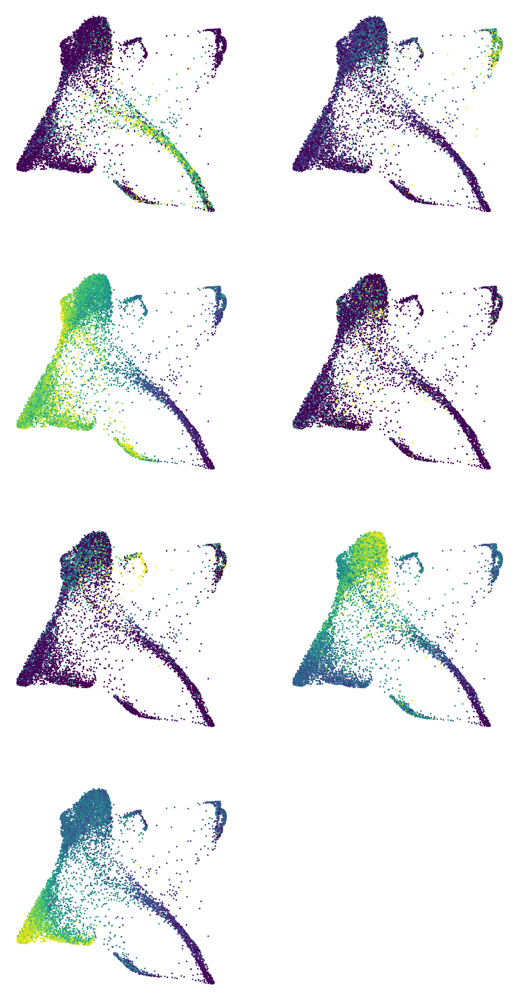

In [29]:
mat = []
fig,axes=plt.subplots(4,2,figsize=(10,20))
i=0
for i,genes in enumerate(cliques_iterative_filtered):
    colors = np.log2(sc.data_normalized[genes].values.mean(1)+.1)
    mat.append(colors)
    order_ = np.random.choice(sc.data.shape[0],size=sc.data.shape[0],replace=False)
    ax = axes.flatten()[i]
    ax.scatter(sc.layout_log.values[:,0][order_],sc.layout_log.values[:,1][order_],c=colors[order_],s=1,
              cmap='viridis',vmin=np.percentile(colors,2),vmax=np.percentile(colors,98))
    ax.set_axis_off()
    ax.set_title("")
    i+=1
while i < 8:
    axes.flatten()[i].set_axis_off()
    i+=1

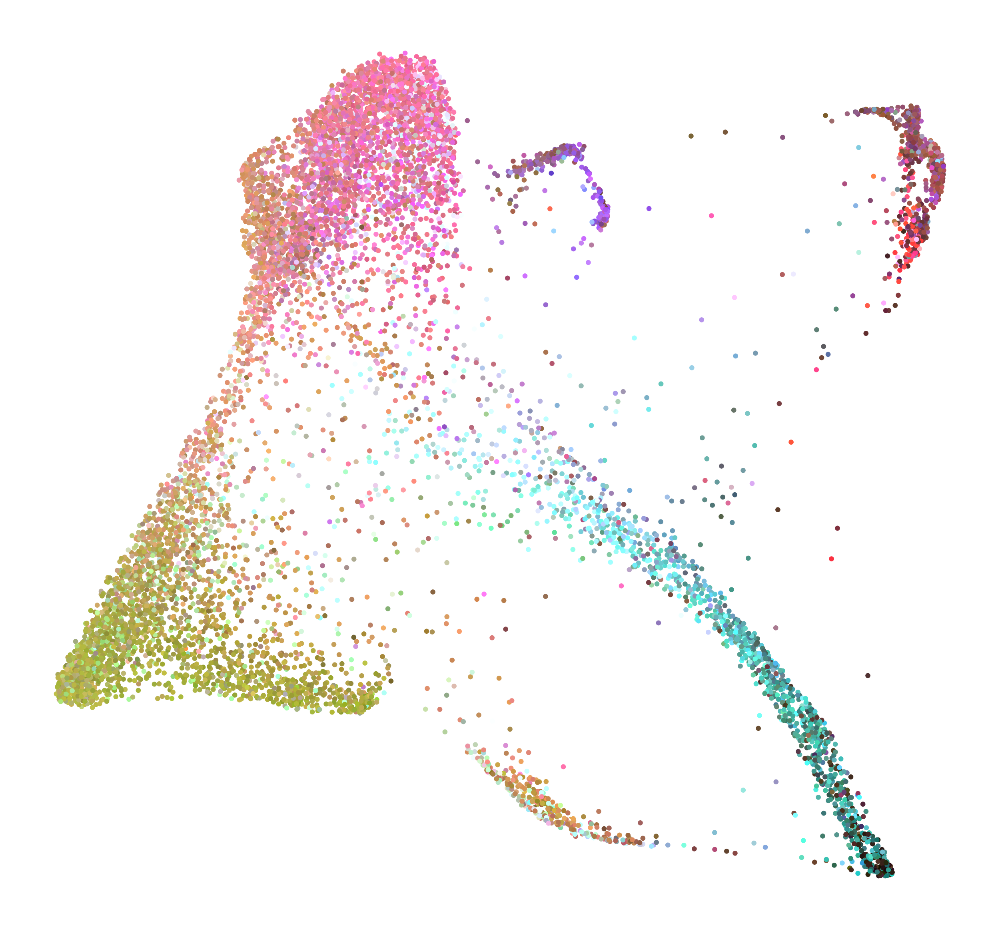

In [30]:
colors_all = np.vstack(mat)[[0,1,2,4,5,6],:]

colors_all = ((colors_all.T-colors_all.min(1))/(colors_all.max(1)-colors_all.min(1))).T

Psuedo_colors = colors_all.T.dot(rgb_cols)
Psuedo_colors[Psuedo_colors > 1] = 1
Psuedo_colors[Psuedo_colors < 0] = 0

fig,ax=plt.subplots(1,1,figsize=(10.5,10))

order_ = np.random.choice(sc.data.shape[0],size=sc.data.shape[0],replace=False)
ax.scatter(sc.layout_log.values[:,0][order_],sc.layout_log.values[:,1][order_],
           c=Psuedo_colors[order_,:],s=5)
ax.set_axis_off()

plt.savefig(working_dir+"final_figures/Figure4/ProgressionCohortInfModules_FDLPseudocolor_Jan-23-22.png",bbox_inches='tight')

## Repeat for Regeneration (T1-T2) and PDAC (T7-T8)

In [31]:
sc_regen = load_sc(working_dir+"saved_analyses/T1-T2_AllGenes_v1.pickle")

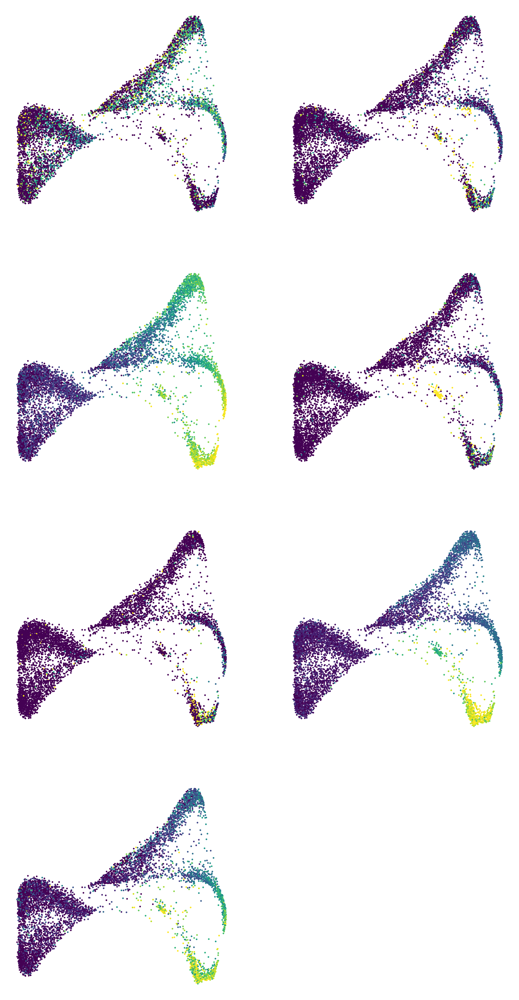

In [32]:
mat_regen = []
fig,axes=plt.subplots(4,2,figsize=(10,20))
i=0
for i,genes in enumerate(cliques_iterative_filtered):
    colors = np.log2(sc_regen.data_normalized[genes].values.mean(1)+.1)
    mat_regen.append(colors)
    order_ = np.random.choice(sc_regen.data.shape[0],size=sc_regen.data.shape[0],replace=False)
    ax = axes.flatten()[i]
    ax.scatter(sc_regen.layout_log.values[:,0][order_],sc_regen.layout_log.values[:,1][order_],c=colors[order_],s=1,
              cmap='viridis',vmin=np.percentile(colors,2),vmax=np.percentile(colors,98))
    ax.set_axis_off()
    ax.set_title("")
    i+=1
while i < 8:
    axes.flatten()[i].set_axis_off()
    i+=1

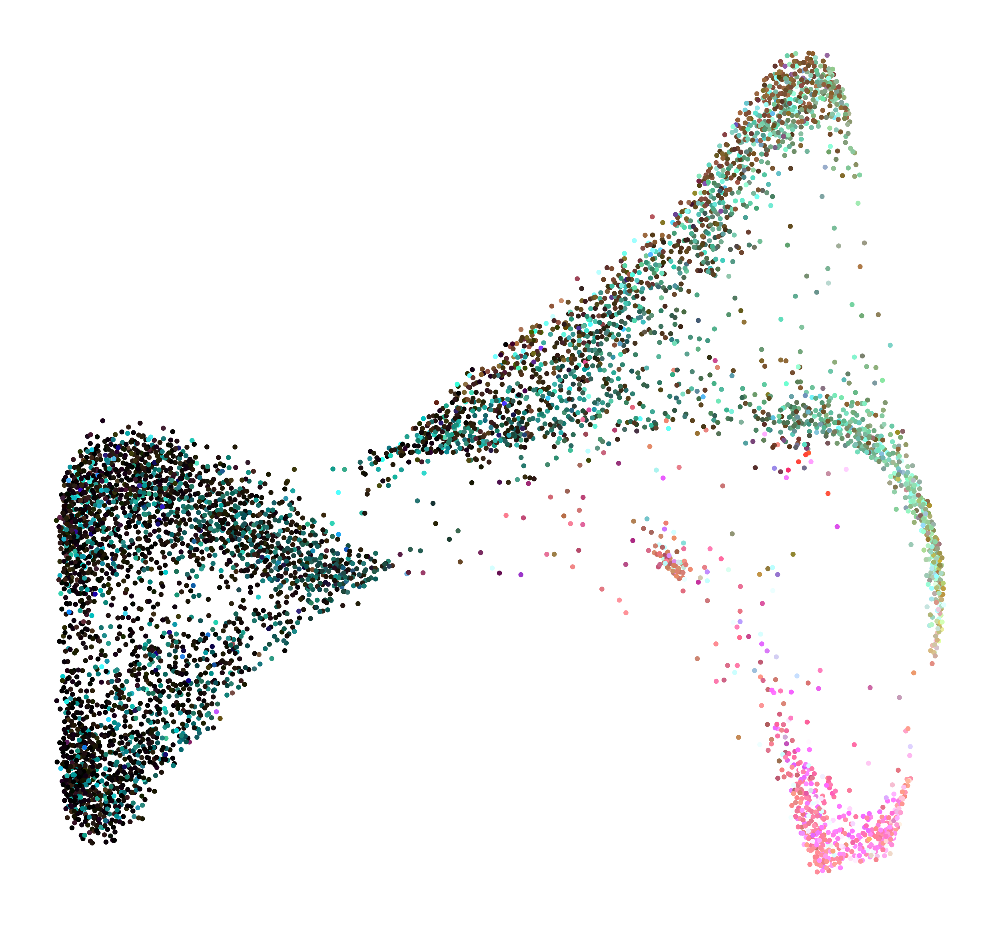

In [33]:
colors_all_regen = np.vstack(mat_regen)[[0,1,2,4,5,6],:]

colors_all_regen = ((colors_all_regen.T-colors_all_regen.min(1))/(colors_all_regen.max(1)-colors_all_regen.min(1))).T

Psuedo_colors = colors_all_regen.T.dot(rgb_cols)
Psuedo_colors[Psuedo_colors > 1] = 1
Psuedo_colors[Psuedo_colors < 0] = 0

fig,ax=plt.subplots(1,1,figsize=(10.5,10))

order_ = np.random.choice(sc_regen.data.shape[0],size=sc_regen.data.shape[0],replace=False)
ax.scatter(sc_regen.layout_log.values[:,0][order_],sc_regen.layout_log.values[:,1][order_],
           c=Psuedo_colors[order_,:],s=5)
ax.set_axis_off()

plt.savefig(working_dir+"final_figures/Figure4/ProgressionCohortInfModules_FDLRegenPseudocolor_Jan-23-22.png",bbox_inches='tight')

In [35]:
sc_regen = load_sc(working_dir+"saved_analyses/T7-T8_2022.pickle")

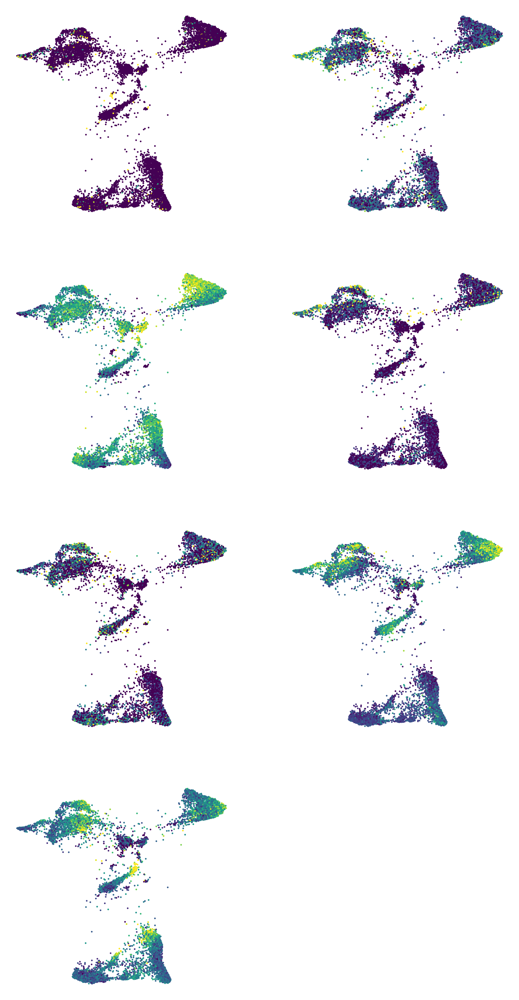

In [36]:
mat_regen = []
fig,axes=plt.subplots(4,2,figsize=(10,20))
i=0
for i,genes in enumerate(cliques_iterative_filtered):
    colors = np.log2(sc_regen.data_normalized_full[genes].values.mean(1)+.1)
    mat_regen.append(colors)
    order_ = np.random.choice(sc_regen.data.shape[0],size=sc_regen.data.shape[0],replace=False)
    ax = axes.flatten()[i]
    ax.scatter(sc_regen.layout_log.values[:,0][order_],sc_regen.layout_log.values[:,1][order_],c=colors[order_],s=1,
              cmap='viridis',vmin=np.percentile(colors,2),vmax=np.percentile(colors,98))
    ax.set_axis_off()
    ax.set_title("")
    i+=1
while i < 8:
    axes.flatten()[i].set_axis_off()
    i+=1

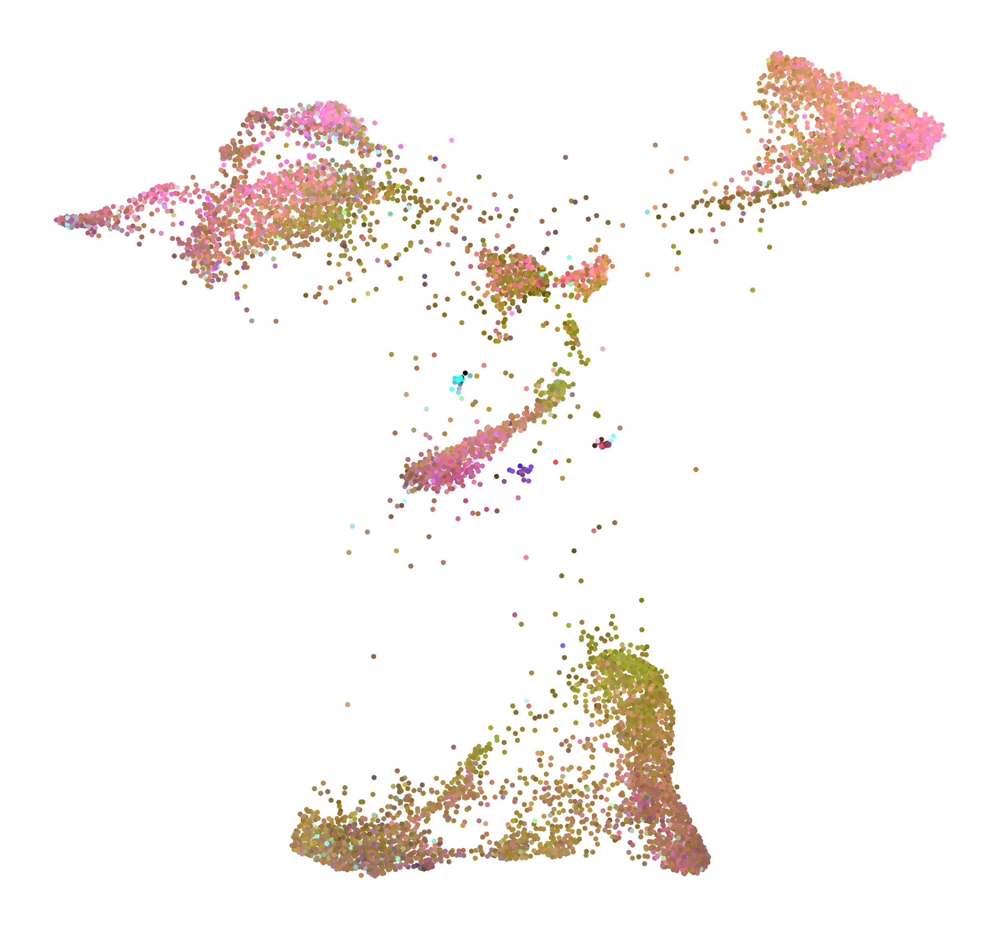

In [37]:
colors_all_regen = np.vstack(mat_regen)[[0,1,2,4,5,6],:]

colors_all_regen = ((colors_all_regen.T-colors_all_regen.min(1))/(colors_all_regen.max(1)-colors_all_regen.min(1))).T

Psuedo_colors = colors_all_regen.T.dot(rgb_cols)
Psuedo_colors[Psuedo_colors > 1] = 1
Psuedo_colors[Psuedo_colors < 0] = 0

fig,ax=plt.subplots(1,1,figsize=(10.5,10))

order_ = np.random.choice(sc_regen.data.shape[0],size=sc_regen.data.shape[0],replace=False)
ax.scatter(sc_regen.layout_log.values[:,0][order_],sc_regen.layout_log.values[:,1][order_],
           c=Psuedo_colors[order_,:],s=5)
ax.set_axis_off()

plt.savefig(working_dir+"final_figures/Figure4/ProgressionCohortInfModules_FDLPDACPseudocolor_Jan-23-22.png",bbox_inches='tight')

In [ ]:
#pickle.dump(Gpruned.subgraph(list(set(np.concatenate(cliques_iterative)))),open("analysis_outputs/crosstalk/Gpruned_Epi.pickle",'wb'))
#pickle.dump(cliques_iterative,open("analysis_outputs/crosstalk/cliques_iterative_Epi.pickle",'wb'))
#pickle.dump(Gpruned.subgraph(list(set(np.concatenate(np.array(cliques_iterative)[cliques_celltype])))),open("analysis_outputs/crosstalk/Gpruned_Epi_small.pickle",'wb'))
#pickle.dump(cliques_iterative_filtered,open("analysis_outputs/crosstalk/cliques_iterative_filtered_Epi.pickle",'wb'))

# Module Annotation

In [38]:
rgb_cols_all = np.array([[0,1,1],
[.7,0,0],
[.6,.6,0],
[0,0,0],                         
[0,0,1],
[1,0,1],
[0,.6,0],])

mat = np.vstack(mat)
mat_norm = ((mat.T - mat.mean(1))/mat.std(1)).T

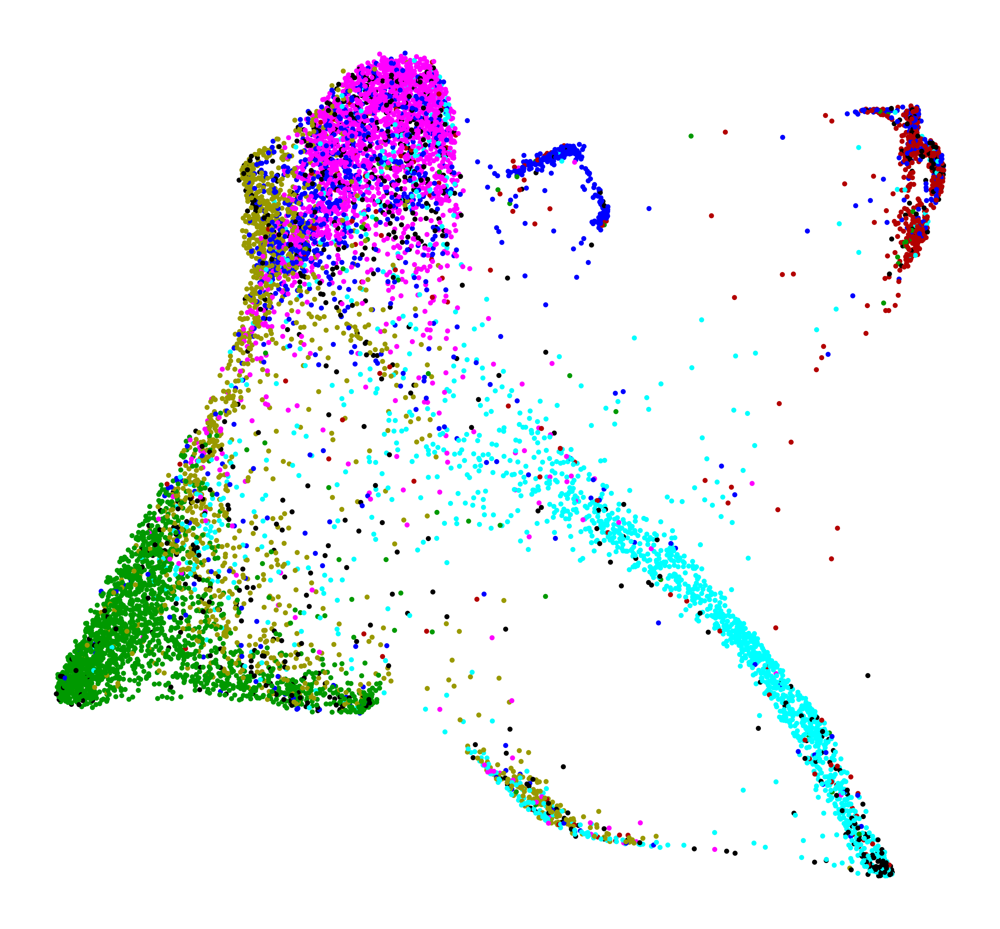

In [39]:
hard_assignments = np.argmax(mat_norm,axis=0)

fig,ax=plt.subplots(1,1,figsize=(10.5,10))
order_ = np.random.choice(sc.data.shape[0],size=sc.data.shape[0],replace=False)
ax.scatter(sc.layout_log.values[:,0][order_],sc.layout_log.values[:,1][order_],
           c=rgb_cols_all[hard_assignments,:][order_,:],s=5)
ax.set_axis_off()

plt.savefig(working_dir+"final_figures/Figure4/ProgressionCohortInfModules_FDLHardAssignment_Jan-23-22.png",bbox_inches='tight')

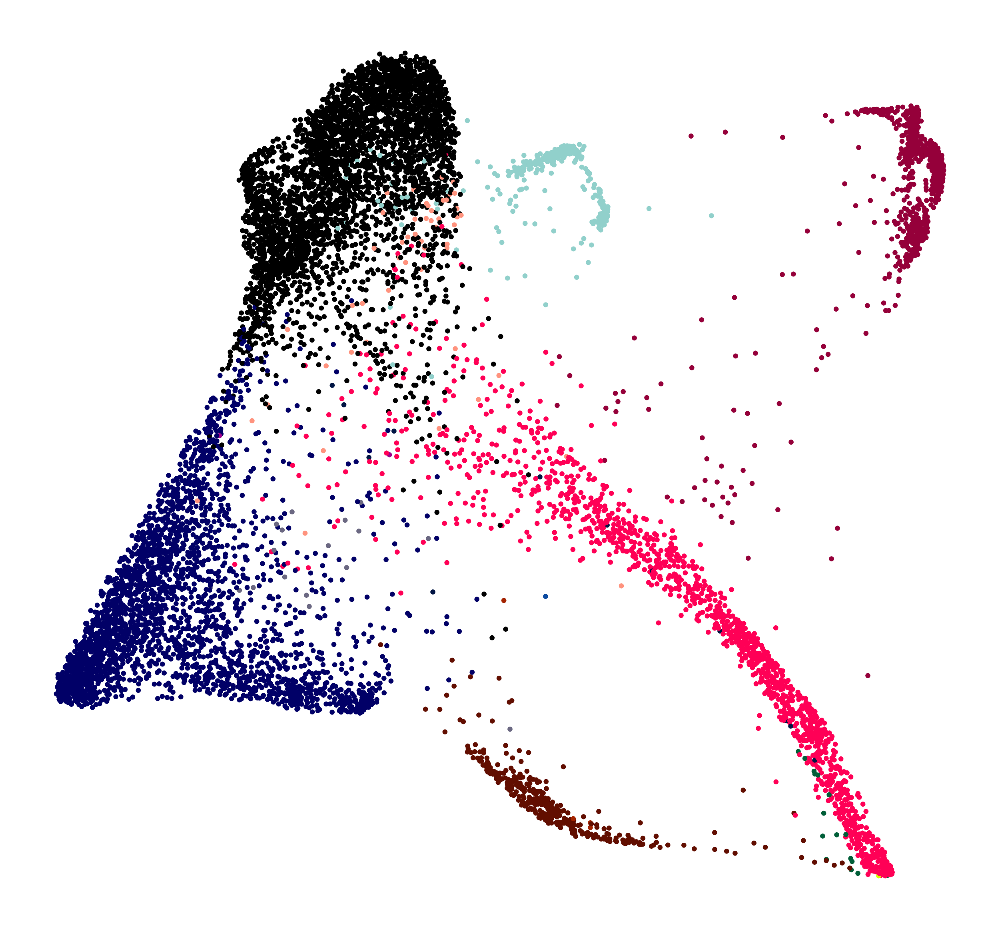

In [40]:
fig,ax=plt.subplots(1,1,figsize=(10.5,10))
cluster_colors = np.array([sc.palette[i] for i in sc.communities_coarse])
order_ = np.random.choice(sc.data.shape[0],size=sc.data.shape[0],replace=False)
ax.scatter(sc.layout_log.values[:,0][order_],sc.layout_log.values[:,1][order_],
           c=cluster_colors[order_],s=5)
ax.set_axis_off()

plt.savefig(working_dir+"final_figures/Figure4/ProgressionCohortInfModules_FDLClusterColor_Jan-23-22.png",bbox_inches='tight')

In [41]:
clusters_all = np.array(list(set(sc.communities_coarse)))
cluster_sizes = [np.sum(sc.communities_coarse==clust) for clust in clusters_all]
cluster_sizes

[3329, 2518, 1, 1320, 2, 1, 16, 645, 53, 4, 12, 279, 328, 17]

In [42]:
clusters_test = clusters_all[np.where(np.array(cluster_sizes)>200)[0]]

In [43]:
mod_cluster_mat = np.zeros((mat_norm.shape[0],len(clusters_test)))
for module in range(mat_norm.shape[0]):
    mod_ix = np.where(hard_assignments==module)[0]
    
    for i,cluster in enumerate(clusters_test):
        cluster_ix = np.where(sc.communities_coarse==cluster)[0]
        mod_cluster_mat[module,i] = len(np.intersect1d(cluster_ix,mod_ix))

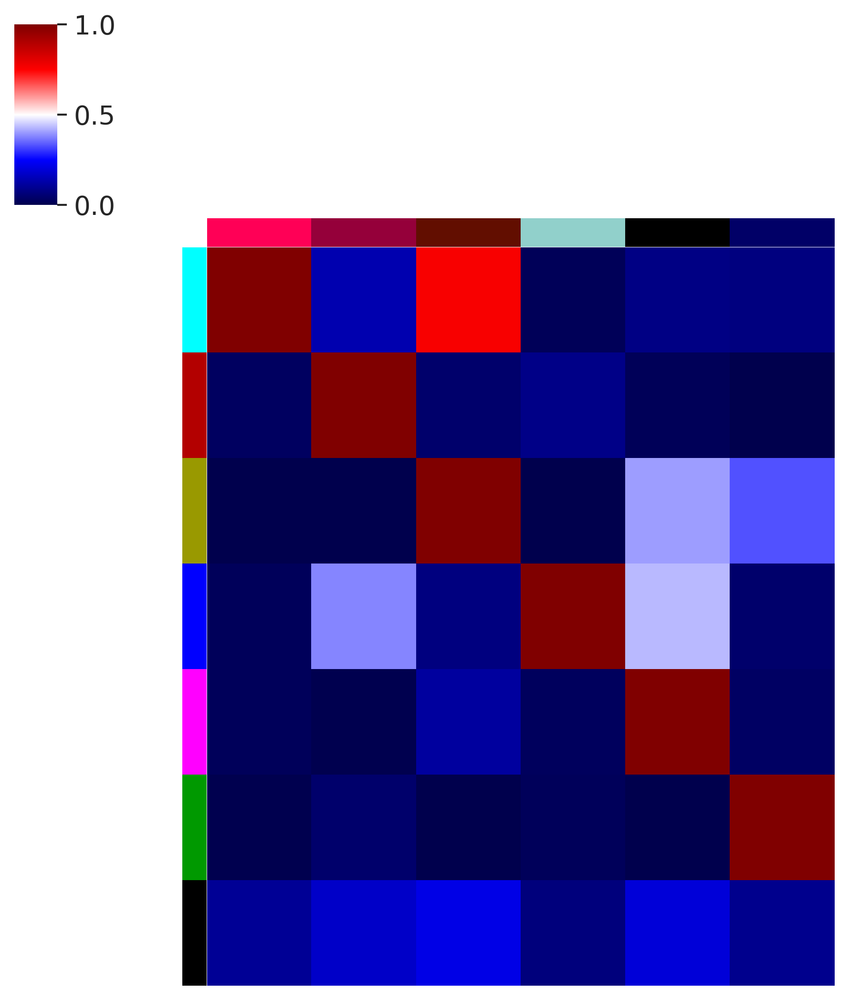

In [44]:
row_order = [0,1,2,4,5,6,3]
col_order = [2,3,5,4,0,1]

col_colors = [sc.palette[i] for i in clusters_test]

sns.clustermap(mod_cluster_mat[row_order,:][:,col_order],standard_scale=1,cmap='seismic',
              figsize=(len(col_order),len(row_order)),row_cluster=False,col_cluster=False,
               xticklabels="",yticklabels="",
               col_colors = np.array(col_colors)[col_order],
               row_colors = rgb_cols_all[row_order,:])

plt.savefig(working_dir+"final_figures/Figure4/ProgressionCohortInfModules_HeatmapModAnn_Jan-23-22.pdf",bbox_inches='tight')

In [45]:
from scipy.stats import entropy

In [46]:
ratios = []
for i in range(len(clusters_test)):
    dist = mod_cluster_mat[:,i]
    max_mod = np.argmax(dist)
    ratio = dist[max_mod] / np.sum(dist)
    ratios.append(ratio)
    print(ratio)

0.45689396215079603
0.6235107227958697
0.8348484848484848
0.5736434108527132
0.8028673835125448
0.4329268292682927


In [47]:
np.mean(ratios)

0.6207817989047836

In [48]:
from sklearn.metrics import adjusted_rand_score

check = np.where(np.array([cell in clusters_test for cell in sc.communities_coarse]))[0]

adjusted_rand_score(hard_assignments[check],sc.communities_coarse[check])

0.35183416171886583

In [49]:
adjusted_rand_score(hard_assignments,sc.communities_coarse)

0.3493487052352983